# imports and single parameter functions


In [ ]:
import pandas as pd
from torch import nn
from IPython.display import clear_output
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import scipy.stats as scs
from sklearn.preprocessing import normalize as norm
from sklearn import linear_model
import datetime
import time
from datetime import datetime , timedelta

import zipfile
import math

from csv import reader
from matplotlib.pyplot import figure
import seaborn as sns;
import re
import torch

In [ ]:
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.metrics import mean_squared_error as mse
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.metrics import mean_squared_error as mse
from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import MultinomialNB
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier
from sklearn.pipeline import make_pipeline
from sklearn import preprocessing
import xgboost as xgb
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import confusion_matrix


In [ ]:
from market_state import *
from models import *

In [ ]:
list_of_companies_number = ['1080', '1113', '1221', '1229', '1243', '1388', '1431', '1472', '1694', '1769', '1865', '1907', '1956', '2028',
                           '2050', '2051', '2057', '2094', '2197', '2290', '2368', '2645', '2651', '2730', '2748', '2813', '2822', '2890', 
                           '3022', '3035', '3107', '3161', '3388', '3459', '3757', '3879', '4060', '4154', '4218', '4320', '4481', 
                            '4549', '4575', '4618', '4695', '4736', '4799', '4851', '5836', '7843', '7858', '8080', '9034', '9058', '9061',
                           '9062', '9063', '9064', '9065', '9067', '9069', '9074', '9086', '9094', '9265', '9266', '9268', '9269',
                            '9270', '9761', '10166', '10470', '10484', '10508', '10795', '10887', '11038', '11234', '11244', '11390', '11399',
                           '11583','11618','11714', '11867', '11869', '11946', '12059', '12098', '12255', '12327', '12417', '12456', '12534',
                           '12552', '12713', '13003', '13061', '13113']

In [ ]:
data = np.zeros(shape = (100, 5100,2,2,10))

# READ DATA

In [ ]:
#shape = [(nr of company, every possible timeslot from 8.00 till 16.29, bid/ask, price/volume, 5 best offers from 9.15!))]
data = np.zeros(shape = (100, 5100,2,2,10))

In [ ]:
# read order books into data
mom_count = 0
count_comp = -1
for num_comp in list_of_companies_number:
    with open('FTSE100\OrderBookSnapshots.csv.'+num_comp+'\OrderBookSnapshots.csv', 'r') as read_obj:
        csv_reader = reader(read_obj)
        count = 0
        count_comp+=1
        prev_hour = 8
        prev_date = '20130902'
        prev_min=0
        prev_elements = []
        for row in csv_reader:
            elements = row[0].split('\t')
            date_time = elements[0]
            date_holder, time_holder = date_time.split(' ')
            if date_holder != prev_date:
                prev_hour = 8
                prev_min=0
            cur_hour = int(time_holder[:2])
            cur_min = int(time_holder[2:4])
            if((cur_hour==8 and cur_min>=0) or (cur_hour>8 and cur_hour<16) or (cur_hour==16 and cur_min<30)):
                data[count_comp][count] = get_k_best_offers(elements[1:], k=10)  
                count+=1
clear_output()

In [ ]:
data[1,0]

array([[[  874. ,   873. ,   872. ,   870. ,   865. ,   862.5,   861. ,
           860. ,   859. ,   858. ],
        [ 5000. ,  1096. , 10000. ,  6000. , 38000. ,   850. ,   555. ,
          5460. , 28555. , 12134. ]],

       [[  804. ,   838. ,   859.5,   864. ,   865. ,   865.5,   866. ,
           866.5,   868. ,   868.5],
        [  137. ,  1042. ,   347. ,   850. ,   702. ,   371. ,   555. ,
          1110. ,  1671. ,   918. ]]])

In [ ]:
# read trades into trades
days={
    2:0,
    3:1,
    4:2,
    5:3,
    6:4,
    9:5,
    10:6,
    11:7,
    12:8,
    13:9,
}
if_first_row = True
which_comp = 0

#comp = list_of_companies_number
comp = list_of_companies_number
comp_id = -1
trades = np.empty( shape=(len(comp), 10), dtype = list)
for i in range(trades.shape[0]):
    for j in range(10):
        trades[i,j]=list()
for num_comp in comp:
    comp_id+=1
    if_first_row = True
    with open('FTSE100trades\TradeDetailsExtract.'+num_comp+'.csv', 'r') as read_obj:
        csv_reader = reader(read_obj)
        for row in csv_reader:
            if if_first_row:
                if_first_row = False
                continue
            date = row[4]
            date_elem = date.split(" ")
            act_day = int(date_elem[0][8:10])
            time_tuple=time.strptime(date_elem[1], '%H:%M:%S')
            time_tuple=(time_tuple.tm_hour, time_tuple.tm_min, time_tuple.tm_sec)
          #  trades=np.append(trades, (row[2], row[3], time_tuple),  axis=1)
            #print("XD", comp_id, act_day, date_elem, row[2], row[3], time_tuple)
            try:
                trades[comp_id][days[act_day]].append((float(row[2]), int(row[3]), time_tuple)) # price, volume, timestamp
            except:
                print("Bad acting day or data, please check both\n", comp_id, act_day)
                print((row[2]), (row[3]), time_tuple)
clear_output()

In [ ]:
print(data.shape)
print(trades.shape)

(100, 5100, 2, 2, 10)
(99, 10)


# HEATMAP

In [ ]:
comp_id = 91
interval=1
time_to_skip=30

mid_price = get_mid_price_comp(comp_id, interval, time_to_skip)
print(mid_price.shape)
true_price = get_true_price_comp(comp_id, interval, time_to_skip)
print(true_price.shape)
order_inbalance = get_order_inbalance_comp(comp_id, interval, time_to_skip)
#order_inbalance = order_inbalance.reshape(10,-1)
print(order_inbalance.shape)
vwaps, order_sizes = get_vwap_and_ordersizes_comp(comp_id, interval, time_to_skip)
vwaps_buy = vwaps[:,::2]
vwaps_sell = vwaps[:,1::2]
print(vwaps_buy.shape)
print(vwaps_sell.shape)
s2f_impact, order_sizes = get_s2f_impact_and_ordersizes_comp(comp_id, interval, time_to_skip)
s2f_impact_buy = s2f_impact[:,::2]
s2f_impact_sell = s2f_impact[:,1::2]
print(s2f_impact_buy.shape)
print(s2f_impact_sell.shape)
order_sizes_buy = order_sizes[:,::2]
order_sizes_sell = order_sizes[:,1::2]
print(order_sizes_buy.shape)
print(order_sizes_sell.shape)
trading_volumes, price_volatilities = get_trading_volume_and_price_volatility(comp_id, interval, time_to_skip)
print(trading_volumes.shape)
print(price_volatilities.shape)
next_trade_time=get_next_trade_x_comp(comp_id, interval, time_to_skip, get_x='time')
next_trade_size=get_next_trade_x_comp(comp_id, interval, time_to_skip, get_x='size')
next_trade_price=get_next_trade_x_comp(comp_id, interval, time_to_skip, get_x='price')
price_change=get_price_change_given_prices(true_price)
print(next_trade_time.shape, next_trade_size.shape, next_trade_price.shape)
print(price_change.shape)

(10, 480)
(10, 480)
(10, 480)
(10, 480)
(10, 480)
30.1875% of intervals were SELL empty
30.354166666666668% of intervals were BUY empty
0.5% of intervals were set not filled
(10, 480)
(10, 480)
(10, 480)
(10, 480)
(10, 480)
(10, 480)
(10, 480) (10, 480) (10, 480)
(10, 480)


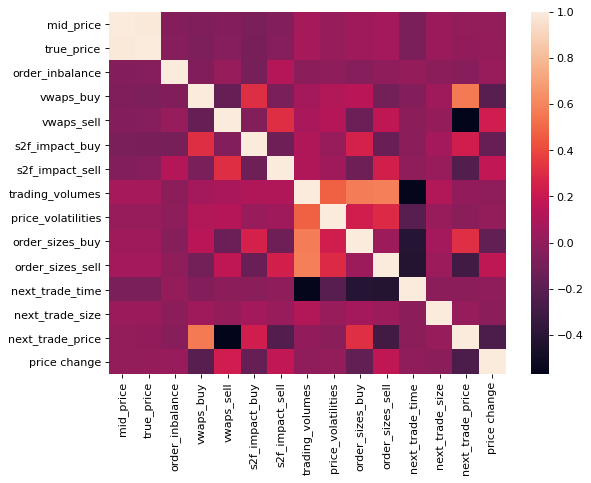

In [ ]:
df = pd.DataFrame({
                'mid_price': mid_price.flatten(), 
                'true_price': true_price.flatten(), 
                'order_inbalance': order_inbalance.flatten(), 
                'vwaps_buy': vwaps_buy.flatten(), 
                'vwaps_sell': vwaps_sell.flatten(), 
                's2f_impact_buy': s2f_impact_buy.flatten(), 
                's2f_impact_sell': s2f_impact_sell.flatten(), 
                'trading_volumes': trading_volumes.flatten(), 
                'price_volatilities': price_volatilities.flatten(),
                'order_sizes_buy': order_sizes_buy.flatten(), 
                'order_sizes_sell': order_sizes_sell.flatten(),
                'next_trade_time': next_trade_time.flatten(),
                'next_trade_size': next_trade_size.flatten(),
                'next_trade_price': next_trade_price.flatten(),
                'price change': price_change.flatten()
                })

figure(figsize=(8, 6), dpi=80)
ax = sns.heatmap(df.corr(method='kendall'))
plt.show()
## small diferences in values depending on company, but more or less the same

# models

In [ ]:
functions_to_call = {
    'mid_price'                              : get_mid_price_comp,
    'true_price'                             : get_true_price_comp,
    'order_inbalance'                        : get_order_inbalance_comp,
    'vwaps_buy'                              : get_vwap_and_ordersizes_comp,
    'vwaps_sell'                             : get_vwap_and_ordersizes_comp,
    'vwaps_order_sizes_buy'                  : get_vwap_and_ordersizes_comp,
    'vwaps_order_sizes_sell'                 : get_vwap_and_ordersizes_comp,
    's2f_impact_buy'                         : get_s2f_impact_and_ordersizes_comp,
    's2f_impact_sell'                        : get_s2f_impact_and_ordersizes_comp,
    's2f_order_sizes_buy'                    : get_s2f_impact_and_ordersizes_comp,
    's2f_order_sizes_sell'                   : get_s2f_impact_and_ordersizes_comp,
    'trading_volumes'                        : get_trading_volume_and_price_volatility,
    'price_volatilities'                     : get_trading_volume_and_price_volatility,
    'next_trade_time'                        : get_next_trade_x_comp,
    'next_trade_size'                        : get_next_trade_x_comp,
    'next_trade_price'                       : get_next_trade_x_comp,
    'price_change'                           : get_price_change_given_prices
}

In [ ]:
names=[         
   # 'mid_price',
    #'true_price', 
    'order_inbalance', 
    'vwaps_buy', 
    'vwaps_sell', 
    's2f_impact_buy', 
    's2f_impact_sell', 
    'trading_volumes', 
    'price_volatilities',
    'vwaps_order_sizes_buy', 
    'vwaps_order_sizes_sell',
    's2f_order_sizes_buy', 
    's2f_order_sizes_sell',
    'next_trade_time',
    'next_trade_size',
    'next_trade_price',
    #'price change'
      ]
param_dict_logreg={}
for n in names:
    param_dict_logreg[n]=[]

In [ ]:
average_comp_price=np.zeros(len(list_of_companies_number))
for i in range(average_comp_price.size):
    average_comp_price[i]=np.average(get_true_price_comp(comp_id=i, interval=1, time_to_skip=30))

In [ ]:
comp_id = 3
interval=5
time_to_skip=30
time_back=1
split_percent = 0.8
epsilon=2.7e-6

In [ ]:
names=[         
   # 'mid_price',
    'true_price', 
    'order_inbalance', 
    'vwaps_buy', 
    'vwaps_sell', 
    's2f_impact_buy', 
    's2f_impact_sell', 
    'trading_volumes', 
    'price_volatilities',
    'vwaps_order_sizes_buy', 
    'vwaps_order_sizes_sell',
    's2f_order_sizes_buy', 
    's2f_order_sizes_sell',
    'next_trade_time',
    'next_trade_size',
    'next_trade_price',
    #'price change'
      ]

In [ ]:
print(average_comp_price[comp_id])
X=get_X(comp_id, interval, time_to_skip, time_back, names)
y=get_y(comp_id, interval, time_to_skip, time_back, y_name='true_price', check='swing_max', threshold=0.0012)
print("decision_tree")
print("score: ",decision_tree(X, np.copy(y),split_percent, comp_id, epsilon, use_pipe=MyNormalizer(norm='l2', axis=0), check_up_down=False, track_params=False,local_names=names))
print("log reg")
print("score: ",logistic_regr(X, y,split_percent, comp_id=comp_id, check_up_down=False, track_params=False, local_names=names))

#print("xgb")
#print("score: ",xgb_model(X, np.copy(y),split_percent, epsilon, comp_id, use_scaling=True, local_names=names))


# Read/write microstruture data set form/to csv

In [ ]:
# read microstructure data set from csv, not to calculate it every time. It takes some time

X_df=pd.read_csv('X_all_1_30_5_0.00167.csv', delimiter=',',header=0) 
y_df=pd.read_csv('y_all_1_30_5_0.00167.csv', delimiter=',',header=0)
X_df.drop(labels=['Unnamed: 0'], axis=1, inplace=True)
X_df.drop(labels=['7'], axis=1, inplace=True) 
X_df
y_df.drop(labels=['Unnamed: 0'], axis=1, inplace=True)
y_df
X_all=np.asarray(X_df)
X_all=X_all.reshape(99, X_all.shape[0]//99, 14)
y_all=np.asarray(y_df)
y_all=y_all.reshape(99, y_all.shape[0]//99 )
X_all.shape, y_all.shape

((99, 4750, 14), (99, 4750))

In [ ]:
interval=1
time_back=5
time_to_skip=30
split_percent = 0.8
threshold=0.00167
names_all=[         
   # 'mid_price',
    'true_price', 
    'order_inbalance', 
    'vwaps_buy', 
    'vwaps_sell', 
    's2f_impact_buy', 
    's2f_impact_sell', 
    'trading_volumes', 
    'price_volatilities',
    'vwaps_order_sizes_buy', 
    'vwaps_order_sizes_sell',
    's2f_order_sizes_buy', 
    's2f_order_sizes_sell',
    'next_trade_time',
    'next_trade_size',
    'next_trade_price',
    #'price change'
      ]
s=get_X(0,interval=interval, time_back=time_back, time_to_skip=time_to_skip, names=names_all).shape
X_allcomps_back_5_th167=np.zeros((len(list_of_companies_number), s[0],s[1]))
y_allcomps_back_5_th167=np.zeros((len(list_of_companies_number), s[0]))

38.166666666666664% of intervals were SELL empty
35.791666666666664% of intervals were BUY empty
0.0625% of intervals were set not filled


In [ ]:
#rerun for price volatilities
for c in range(len(list_of_companies_number)):
    print(c)
    
    X_hold=get_X(comp_id=c,interval=interval, time_back=time_back, time_to_skip=time_to_skip, names=names_all)
    transformer = preprocessing.MaxAbsScaler().fit(X_hold)
    X_allcomps_back_5_th167[c]=transformer.transform(X_hold)
    y_allcomps_back_5_th167[c]=get_y(comp_id=c,interval=interval, time_back=time_back, time_to_skip=time_to_skip, y_name='true_price', 
                        check='swing_max', swing_interval=60, threshold=threshold)
clear_output()

In [ ]:
X_all_df=pd.DataFrame(X_allcomps_back_5_th167.reshape((len(list_of_companies_number)*s[0], s[1])))
y_all_df=pd.DataFrame(y_allcomps_back_5_th167.flatten())
X_all_df.to_csv('X_all_{}_{}_{}_{}.csv'.format(interval,time_to_skip, time_back, threshold))
y_all_df.to_csv('y_all_{}_{}_{}_{}.csv'.format( interval,time_to_skip, time_back, threshold))

# Market hypeparameters selection


## find threshold for price swing

In [ ]:
time_back=5
time_to_skip=30
split_percent = 0.8
interval=1
names_all=[         
   # 'mid_price',
    'true_price', 
    'order_inbalance', 
    'vwaps_buy', 
    'vwaps_sell', 
    's2f_impact_buy', 
    's2f_impact_sell', 
    'trading_volumes', 
    'price_volatilities',
    'vwaps_order_sizes_buy', 
    'vwaps_order_sizes_sell',
    's2f_order_sizes_buy', 
    's2f_order_sizes_sell',
    'next_trade_time',
    'next_trade_size',
    'next_trade_price',
    #'price change'
      ]
thresholds=np.logspace(-8, -3, num=6)
comp_ths=np.zeros((len(list_of_companies_number), len(thresholds),3))

In [ ]:
thresholds

array([1.e-08, 1.e-07, 1.e-06, 1.e-05, 1.e-04, 1.e-03])

In [ ]:
time_start=time.time()
for comp_id in range(len(list_of_companies_number)):
    print(comp_id)
    X=get_X(comp_id, interval, time_to_skip, time_back, names) 
    for th in range(len(thresholds)):
        print('threshold ', thresholds[th])
      #  print(X.shape)
        y=get_y(comp_id, interval, time_to_skip, time_back, y_name='true_price', 
                check='swing_max', swing_interval=60, threshold=thresholds[th])
        #X,y=X_allcomps_back_5_th167[comp_id],y_allcomps_back_5_th167[comp_id]
        #print(y.shape)
        comp_ths[comp_id,th,0],comp_ths[comp_id,th,1],comp_ths[comp_id,th,2]=logistic_regr(X, y,split_percent, comp_id=comp_id, check_up_down=False, track_params=False, local_names=names_all)
clear_output()
print("calculations took: {} seconds".format(  time.time()-time_start))

calculations took: 34.96187424659729 seconds


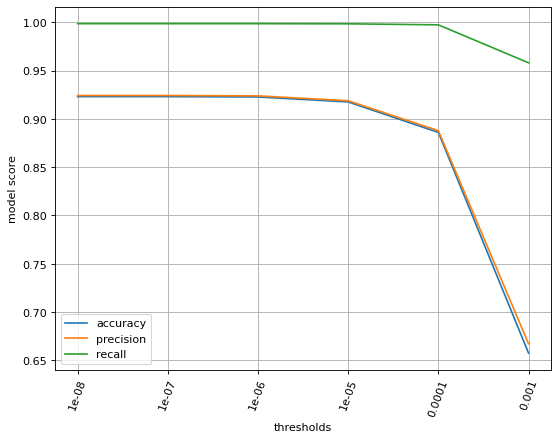

In [ ]:
figure(figsize=(8, 6), dpi=80)
plt.axes(xlabel='thresholds', ylabel='model score')
plt.xticks(np.arange(len(thresholds)), thresholds, rotation='70')
plt.grid()
for i in range(3):
    plt.plot(np.sum(comp_ths, axis=0)[:,i]/99)
plt.legend(['accuracy', 'precision', 'recall'])

In [ ]:
thresholds=np.arange(8*1e-4, 3*1e-3, step=1e-4)
comp_ths=np.zeros((len(list_of_companies_number), len(thresholds),3))

In [ ]:
thresholds

array([0.0008, 0.0009, 0.001 , 0.0011, 0.0012, 0.0013, 0.0014, 0.0015,
       0.0016, 0.0017, 0.0018, 0.0019, 0.002 , 0.0021, 0.0022, 0.0023,
       0.0024, 0.0025, 0.0026, 0.0027, 0.0028, 0.0029])

In [ ]:
time_start=time.time()
for comp_id in range(len(list_of_companies_number)):
    print(comp_id)
    X=get_X(comp_id, interval, time_to_skip, time_back, names) 
    for th in range(len(thresholds)):
        print('threshold ', thresholds[th])
       # print(X.shape)
        y=get_y(comp_id, interval, time_to_skip, time_back, y_name='true_price', 
                check='swing_max', swing_interval=60, threshold=thresholds[th])
     #   X,y=permutate_Xy(X_hold,y)
      #  print(y.shape)
        comp_ths[comp_id,th,0],comp_ths[comp_id,th,1],comp_ths[comp_id,th,2]=logistic_regr(X, y,split_percent, 
                                                                                           comp_id=comp_id, check_up_down=False, track_params=False, local_names=names_all)
clear_output()
print("calculations took: {} seconds".format(  time.time()-time_start))

calculations took: 76.06475257873535 seconds


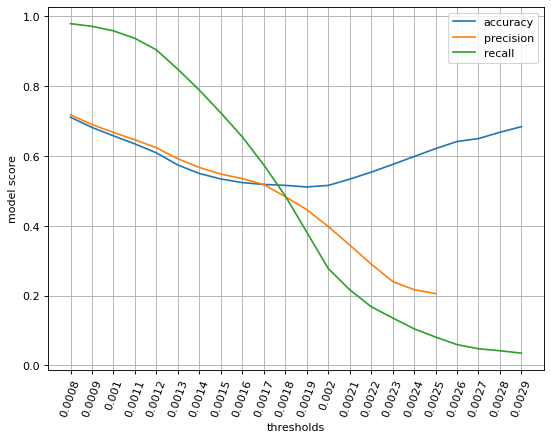

In [ ]:
figure(figsize=(8, 6), dpi=80)
plt.axes(xlabel='thresholds', ylabel='model score')
plt.xticks(np.arange(len(thresholds)), np.round(thresholds, decimals=4), rotation='70')
plt.grid()
for i in range(3):
    plt.plot(np.sum(comp_ths, axis=0)[:,i]/99)
plt.legend(['accuracy', 'precision', 'recall'])

## pick interval

In [ ]:
time_back=1
time_to_skip=30
split_percent = 0.8
threshold = 0.0012
names=[         
   # 'mid_price',
    'true_price', 
    'order_inbalance', 
    'vwaps_buy', 
    'vwaps_sell', 
    's2f_impact_buy', 
    's2f_impact_sell', 
    'trading_volumes', 
    'price_volatilities',
    'vwaps_order_sizes_buy', 
    'vwaps_order_sizes_sell',
    's2f_order_sizes_buy', 
    's2f_order_sizes_sell',
    'next_trade_time',
    'next_trade_size',
    'next_trade_price',
    #'price change'
      ]
intervals=[1,3,5,10,15,30]
comp_ints=np.zeros((len(list_of_companies_number), len(intervals),3))

In [ ]:
time_start=time.time()
for comp_id in range(len(list_of_companies_number)//10):
    print(comp_id)
    for i in range(len(intervals)):
        X_hold=get_X(comp_id, intervals[i], time_to_skip, time_back, names) 
        print('interval ', intervals[i])
        print(X.shape)
        y=get_y(comp_id, intervals[i], time_to_skip, time_back, y_name='true_price', 
                check='swing_max', swing_interval=60, threshold=threshold)
        print(y.shape)
        X,y=permutate_Xy(X_hold,y)
        comp_ints[comp_id,i,0],comp_ints[comp_id,i,1],comp_ints[comp_id,i,2]=logistic_regr(X, y,split_percent, 
                                                                                           comp_id=comp_id, check_up_down=False, track_params=False, local_names=names)
clear_output()

print("calculations took: {} seconds".format(  time.time()-time_start))

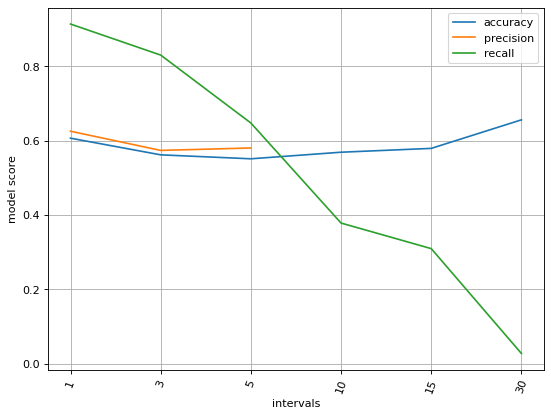

In [ ]:
figure(figsize=(8, 6), dpi=80)
plt.axes(xlabel='intervals', ylabel='model score')
plt.xticks(np.arange(len(intervals)), intervals, rotation='70')
plt.grid()
for i in range(3):
    plt.plot(np.sum(comp_ints, axis=0)[:,i]/9)
plt.legend(['accuracy', 'precision', 'recall'])

## pick threshold for most balanced dataset


In [ ]:
interval=1
time_back=5
time_to_skip=30
split_percent = 0.8
thresholds=np.arange(1.6*1e-3, 1.7*1e-3, step=1e-5)
#np.append(np.array([1.2*1e-3]),np.arange(1.6*1e-3, 1.7*1e-3, step=1e-5))
balance=np.zeros((len(list_of_companies_number), 10, len(thresholds), 2))

In [ ]:
thresholds

array([0.0016 , 0.00161, 0.00162, 0.00163, 0.00164, 0.00165, 0.00166,
       0.00167, 0.00168, 0.00169])

In [ ]:
np.append(np.array([1.2*1e-3]),np.arange(1.6*1e-3, 1.7*1e-3, step=1e-5))

array([0.0012 , 0.0016 , 0.00161, 0.00162, 0.00163, 0.00164, 0.00165,
       0.00166, 0.00167, 0.00168, 0.00169])

In [ ]:
for comp_id in range(len(list_of_companies_number)):
    print(comp_id)
    for th in range(len(thresholds)):
        y=get_y(comp_id, interval, time_to_skip, time_back, y_name='true_price', 
            check='swing_max', swing_interval=60, threshold=thresholds[th])
        pom=y.size//10
        for day in range(10):
            balance[comp_id,day, th, 0]=np.sum(y[day*pom:(day+1)*pom])
            balance[comp_id,day, th, 1]=pom - np.sum(y[day*pom:(day+1)*pom])
    clear_output(wait=True)

98


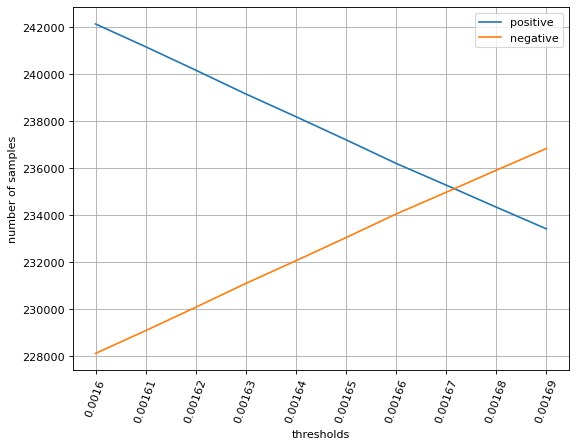

In [ ]:
# all companies on all days

figure(figsize=(8, 6), dpi=80)
plt.axes(xlabel='thresholds', ylabel='number of samples')
plt.xticks(np.arange(len(thresholds)), np.round(thresholds, decimals=5), rotation='70')
plt.grid()
for i in range(2):
    plt.plot(np.sum(balance, axis=(0,1))[:,i])
plt.legend(['positive', 'negative'])

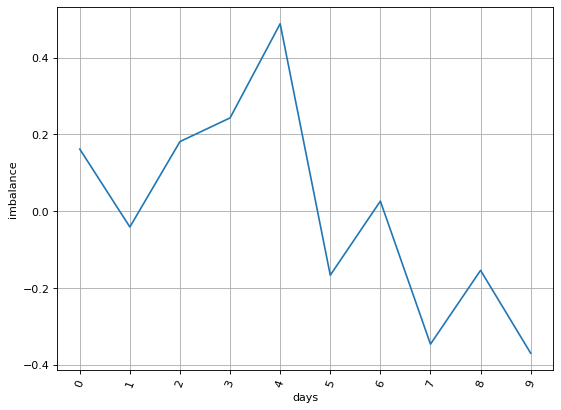

In [ ]:
# all companies on all thresholds   ##0.00167 =thresholds[7]
# plot log2(positive/negative)

figure(figsize=(8, 6), dpi=80)
plt.axes(xlabel='days', ylabel='imbalance')
plt.xticks(np.arange(10),  rotation='70')
plt.grid()
#for i in range(10):
plt.plot(np.log2(np.sum(balance, axis=(0))[:,7,0]/np.sum(balance, axis=(0))[:,7,1]))
#plt.legend(['positive', 'negative'])
#plt.legend(thresholds)

In [ ]:
for i in range(10):
    print("threshold: " ,thresholds[i], "average class imbalance: ")
    print(np.sum(np.log2(np.sum(balance, axis=(0))[:,i,0]/np.sum(balance, axis=(0))[:,i,1])/10))

threshold:  0.0012 average class imbalance: 
0.615342798824659
threshold:  0.0016 average class imbalance: 
0.08684610685264377
threshold:  0.00161 average class imbalance: 
0.07486345368106365
threshold:  0.0016200000000000001 average class imbalance: 
0.06254473076539538
threshold:  0.0016300000000000002 average class imbalance: 
0.050007007146666796
threshold:  0.0016400000000000002 average class imbalance: 
0.03806130609272214
threshold:  0.0016500000000000002 average class imbalance: 
0.02588153784237071
threshold:  0.0016600000000000002 average class imbalance: 
0.013460541888116004
threshold:  0.0016700000000000003 average class imbalance: 
0.0020228091177978136
threshold:  0.0016800000000000003 average class imbalance: 
-0.009594211974930659


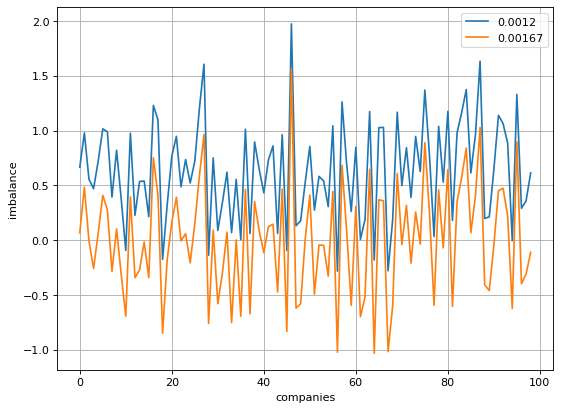

In [ ]:
# companies (x) on all days  0.00167 =thresholds[7]
# plot log2(positive/negative)

figure(figsize=(8, 6), dpi=80)
plt.axes(xlabel='companies', ylabel='imbalance')
#plt.xticks(np.arange(10),  rotation='70')
plt.grid()
#for i in range(10):
plt.plot(np.log2(np.sum(balance, axis=(1))[:,0,0]/np.sum(balance, axis=(1))[:,0,1]))

plt.plot(np.log2(np.sum(balance, axis=(1))[:,8,0]/np.sum(balance, axis=(1))[:,8,1]))
#plt.legend(['positive', 'negative'])
plt.legend([0.0012, 0.00167])

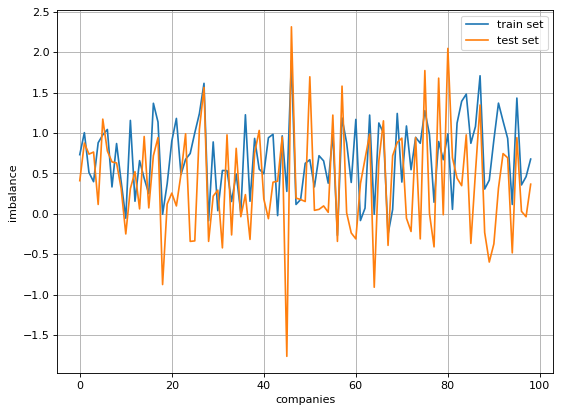

In [ ]:
# companies (x) on each day 
# plot log2(positive/negative)

figure(figsize=(8, 6), dpi=80)
plt.axes(xlabel='companies', ylabel='imbalance')
#plt.xticks(np.arange(10),  rotation='70')
plt.grid()
#for i in range(10):
plt.plot(np.log2(np.sum(balance[:,0:8], axis=(1))[:,0,0]/np.sum(balance[:,0:8], axis=(1))[:,0,1]))
plt.plot(np.log2(np.sum(balance[:,8:], axis=(1))[:,0,0]/np.sum(balance[:,8:], axis=(1))[:,0,1]))

#plt.plot(np.abs(np.log2(np.sum(balance[:,0:8], axis=(1))[:,0,0]/np.sum(balance[:,0:8], axis=(1))[:,0,1])
 #       -np.log2(np.sum(balance[:,8:], axis=(1))[:,0,0]/np.sum(balance[:,8:], axis=(1))[:,0,1])))
#plt.legend(['positive', 'negative'])
plt.legend(["train set", "test set", "abs(difference)"])

### compare times when model is bad, almost always(recall>0.9 or <0.1) predicts either pos or neg class

In [ ]:
interval=1
time_back=5
time_to_skip=30
split_percent = 0.8
thresholds_compare = (0.0012, 0.00167)
names_all=[         
   # 'mid_price',
    'true_price', 
    'order_inbalance', 
    'vwaps_buy', 
    'vwaps_sell', 
    's2f_impact_buy', 
    's2f_impact_sell', 
    'trading_volumes', 
    'price_volatilities',
    'vwaps_order_sizes_buy', 
    'vwaps_order_sizes_sell',
    's2f_order_sizes_buy', 
    's2f_order_sizes_sell',
    'next_trade_time',
    'next_trade_size',
    'next_trade_price',
    #'price change'
      ]
comps=np.arange(len(list_of_companies_number))
scores_all_compare_th=np.zeros(shape=(len(comps), 10, 2, 4)) #company, i-th try, threshold, (acc,prec,recall,check_preds)

In [ ]:
for c in range(len(comps)):
    print(c)
    X_hold=get_X(comps[c], interval, time_to_skip, time_back, names_all)
    for th in range(2):
        y_hold=get_y(comps[c], interval, time_to_skip, time_back, y_name='true_price', check='swing_max', threshold=thresholds_compare[th])
        for i in range(10):
            X,y=X_hold,y_hold
            scores_all_compare_th[c,i,th,0], scores_all_compare_th[c,i,th,1],scores_all_compare_th[c,i,th,2]=(logistic_regr(X, np.copy(y),split_percent, comp_id, check_up_down=False, local_names=names_all))
            if  scores_all_compare_th[c,i,th,2]>0.9 or  scores_all_compare_th[c,i,th,2]<0.1:
                 scores_all_compare_th[c,i,th,3]=True 
#np will parse above to one, true as if model is super bad, almost always returns either pos or neg class
clear_output(wait)

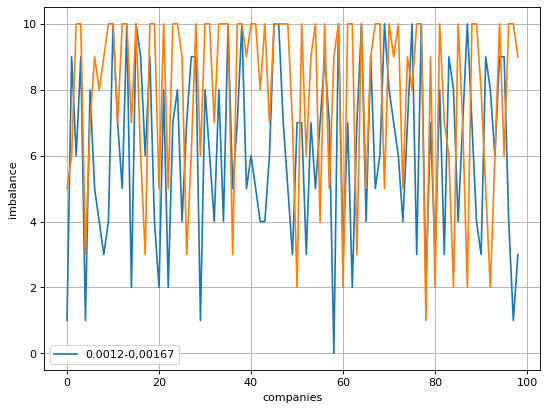

In [ ]:
figure(figsize=(8, 6), dpi=80)
plt.axes(xlabel='companies', ylabel='imbalance')
#plt.xticks(np.arange(10),  rotation='70')
plt.grid()
#for i in range(10):
plt.plot(np.sum(scores_all_compare_th[:,:,0,3], axis=(1)))#-
plt.plot(np.sum(scores_all_compare_th[:,:,1,3], axis=(1)))


#plt.legend(['positive', 'negative'])
plt.legend(["0.0012","0,00167",])


In [ ]:
print("0.0012: ", (np.sum(scores_all_compare_th[:,:,0,3], axis=(0,1))))
print("0.00167: ",(np.sum(scores_all_compare_th[:,:,1,3], axis=(0,1))))


0.0012:  610.0
0.00167:  777.0


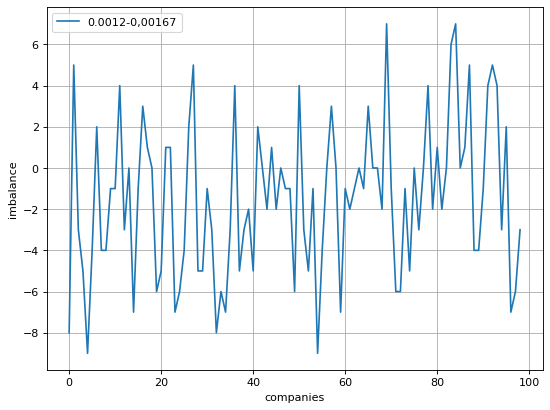

In [ ]:
figure(figsize=(8, 6), dpi=80)
plt.axes(xlabel='companies', ylabel='imbalance')
#plt.xticks(np.arange(10),  rotation='70')
plt.grid()
#for i in range(10):
plt.plot(np.sum(scores_all_compare_th[:,:,0,3], axis=(1))-(np.sum(scores_all_compare_th[:,:,1,3], axis=(1))))


#plt.legend(['positive', 'negative'])
plt.legend(["0.0012-0,00167",])


### as above, but with l2 normalization

In [ ]:
interval=1
time_back=5
time_to_skip=30
split_percent = 0.8
thresholds_compare = (0.0012, 0.00167)
names_all=[         
   # 'mid_price',
    'true_price', 
    'order_inbalance', 
    'vwaps_buy', 
    'vwaps_sell', 
    's2f_impact_buy', 
    's2f_impact_sell', 
    'trading_volumes', 
    'price_volatilities',
    'vwaps_order_sizes_buy', 
    'vwaps_order_sizes_sell',
    's2f_order_sizes_buy', 
    's2f_order_sizes_sell',
    'next_trade_time',
    'next_trade_size',
    'next_trade_price',
    #'price change'
      ]
comps=np.arange(len(list_of_companies_number))
scores_all_compare_th_norm=np.zeros(shape=(len(comps), 10, 2, 4)) #company, i-th try, threshold, (acc,prec,recall,check_preds)

In [ ]:
for c in range(len(comps)):
    print(c)
    X_hold=X_all[c]
    for th in range(2):
        y_hold=get_y(comps[c], interval, time_to_skip, time_back, y_name='true_price', check='swing_max', threshold=thresholds_compare[th])
        for i in range(10):
            X,y=permutate_Xy(X_hold,y_hold)
            scores_all_compare_th_norm[c,i,th,0], scores_all_compare_th_norm[c,i,th,1],scores_all_compare_th_norm[c,i,th,2]=(
                logistic_regr(X, np.copy(y),split_percent, comp_id, use_pipe=MyNormalizer(axis=0,norm='l2'),
                              check_up_down=False, local_names=names_all))
            if  scores_all_compare_th_norm[c,i,th,2]>0.9 or  scores_all_compare_th_norm[c,i,th,2]<0.1:
                 scores_all_compare_th_norm[c,i,th,3]=True 
#np will parse above to one, true as if model is super bad, almost always returns either pos or neg class
clear_output()

In [ ]:
for c in range(len(comps)):
    print(c)
    for th in range(2):
        for i in range(10):

            if  scores_all_compare_th_norm[c,i,th,2]>0.9 or  scores_all_compare_th_norm[c,i,th,2]<0.1:
                 scores_all_compare_th_norm[c,i,th,3]=True 
#np will parse above to one, true as if model is super bad, almost always returns either pos or neg class
clear_output()

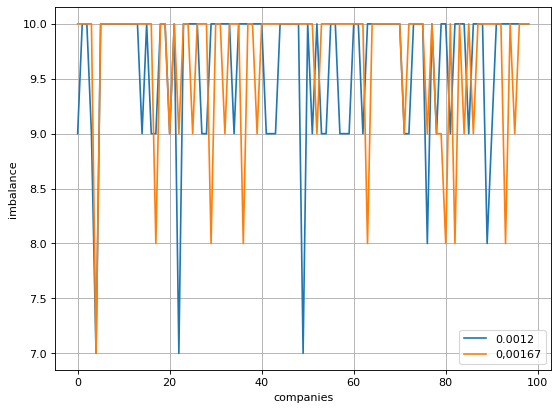

In [ ]:
figure(figsize=(8, 6), dpi=80)
plt.axes(xlabel='companies', ylabel='imbalance')
#plt.xticks(np.arange(10),  rotation='70')
plt.grid()
#for i in range(10):
plt.plot(np.sum(scores_all_compare_th_norm[:,:,0,3], axis=(1)))#-
plt.plot(np.sum(scores_all_compare_th_norm[:,:,1,3], axis=(1)))


#plt.legend(['positive', 'negative'])
plt.legend(["0.0012","0,00167",])

## time back

In [ ]:
interval=1
time_to_skip=30
split_percent = 0.8
threshold = 0.00167
names_all=[         
   # 'mid_price',
    'true_price', 
    'order_inbalance', 
    'vwaps_buy', 
    'vwaps_sell', 
    's2f_impact_buy', 
    's2f_impact_sell', 
    'trading_volumes', 
   # 'price_volatilities',
    'vwaps_order_sizes_buy', 
    'vwaps_order_sizes_sell',
    's2f_order_sizes_buy', 
    's2f_order_sizes_sell',
    'next_trade_time',
    'next_trade_size',
    'next_trade_price',
    #'price change'
      ]
backs=[1,3,5,10,15,30]
comp_backs=np.zeros((len(list_of_companies_number), len(backs),3))

In [ ]:
time_start=time.time()
for comp_id in range(len(list_of_companies_number)//10):
    print(comp_id)
    for i in range(len(backs)):
        X=get_X(comp_id, interval, time_to_skip, backs[i], names) 
        print('time back ', backs[i])
        print(X.shape)
        y=get_y(comp_id, interval, time_to_skip, backs[i], y_name='true_price', 
                check='swing_max', swing_interval=60, threshold=threshold)
        print(y.shape)
        comp_backs[comp_id,i,0],comp_backs[comp_id,i,1],comp_backs[comp_id,i,2]=logistic_regr(X, y,split_percent, 
                                                                                           comp_id=comp_id, check_up_down=False, track_params=False, local_names=names_all)
clear_output()
print("calculations took: {} seconds".format(  time.time()-time_start))

calculations took: 154.02020072937012 seconds


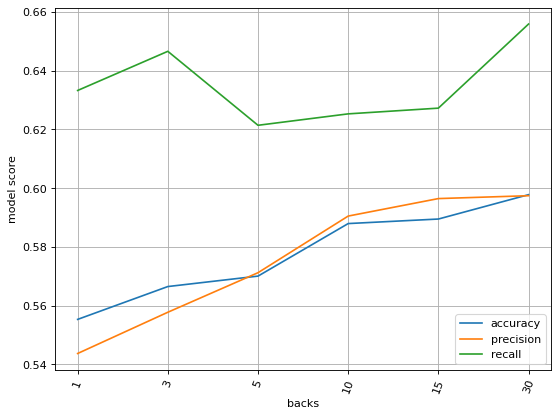

In [ ]:
figure(figsize=(8, 6), dpi=80)
plt.axes(xlabel='backs', ylabel='model score')
plt.xticks(np.arange(len(backs)), backs, rotation='70')
plt.grid()
for i in range(3):
    plt.plot(np.sum(comp_backs, axis=0)[:,i]/9)
plt.legend(['accuracy', 'precision', 'recall'])

# Comparison of logreg preformance on raw, scaled and normalized data

In [ ]:
interval=1
time_back=5
time_to_skip=30
split_percent = 0.8
threshold = 0.00167
names_all=[         
   # 'mid_price',
    'true_price', 
    'order_inbalance', 
    'vwaps_buy', 
    'vwaps_sell', 
    's2f_impact_buy', 
    's2f_impact_sell', 
    'trading_volumes', 
    'price_volatilities',
    'vwaps_order_sizes_buy', 
    'vwaps_order_sizes_sell',
    's2f_order_sizes_buy', 
    's2f_order_sizes_sell',
    'next_trade_time',
    'next_trade_size',
    'next_trade_price',
    #'price change'
      ]
scalers=[None, preprocessing.StandardScaler(), preprocessing.MaxAbsScaler(), MyNormalizer(norm='l1',axis=0),MyNormalizer(norm='l2',axis=0)]
comp_scalers=np.zeros((len(list_of_companies_number),10, len(scalers),4)) #acc, prec,rec,time


In [ ]:
for comp_id in range(len(list_of_companies_number)):
    print(comp_id)
  #  X=X_all[comp_id]
   # y=y_all[comp_id]
    X=get_X(comp_id, interval, time_to_skip, time_back, names) 
    y=get_y(comp_id, interval, time_to_skip, time_back, y_name='true_price', 
            check='swing_max', swing_interval=60, threshold=threshold)
    for j in range(3): #average cmoputations
        for i in range(len(scalers)):
            print(scalers[i])
            time_start=time.time()
            comp_scalers[comp_id,j,i,0],comp_scalers[comp_id,j,i,1],comp_scalers[comp_id,j,i,2]=logistic_regr(X, y,split_percent, 
                                                                                               comp_id=comp_id, use_pipe=scalers[i], check_up_down=False, track_params=False, local_names=names_all)
            comp_scalers[comp_id,j,i,3]=time.time()-time_start

    clear_output(wait=True)


In [ ]:
df=pd.DataFrame(np.round(np.nansum(comp_scalers, axis=(0,1))/(99*3), decimals=3))
df

,0,1,2,3
0,0.548,0.416,0.565,0.158
1,0.557,0.483,0.494,0.151
2,0.550,0.457,0.553,0.069
3,0.548,0.277,0.545,0.086
4,0.548,0.417,0.574,0.083


In [ ]:
interval=1
time_back=5
time_to_skip=30
split_percent = 0.8
threshold = 0.0016

In [ ]:
samples_class=np.zeros((len(list_of_companies_number), 2))

In [ ]:
for comp_id in range(len(list_of_companies_number)):
    print(comp_id)
    y=get_y(comp_id, interval, time_to_skip, time_back, y_name='true_price', 
            check='swing_max', swing_interval=60, threshold=threshold)
    #print(y.shape)
    dlugosc=y.size
    split=int(dlugosc*0.8)
    samples_class[comp_id,0]=np.sum(y[split:])
    samples_class[comp_id,1]=(dlugosc-split)-np.sum(y[split:])
    clear_output(wait=True)

98


In [ ]:
counter=0
for pair, comp_id in zip(samples_class, np.arange(len(list_of_companies_number))):
    if  pair[0]/pair[1]>2/1 or pair[0]/pair[1]<1/2:
        counter+=1
        print("company {}, positive/negative ratio: {}".format(comp_id, pair[0]/pair[1]))
print(counter)

company 1, positive/negative ratio: 2.054662379421222
company 2, positive/negative ratio: 2.0351437699680512
company 3, positive/negative ratio: 2.015873015873016
company 5, positive/negative ratio: 2.5185185185185186
company 6, positive/negative ratio: 2.177257525083612
company 8, positive/negative ratio: 2.1147540983606556
company 14, positive/negative ratio: 2.3333333333333335
company 16, positive/negative ratio: 2.074433656957929
company 17, positive/negative ratio: 2.2203389830508473
company 23, positive/negative ratio: 2.7109375
company 26, positive/negative ratio: 2.5849056603773586
company 27, positive/negative ratio: 3.3577981651376145
company 32, positive/negative ratio: 2.177257525083612
company 34, positive/negative ratio: 2.2758620689655173
company 39, positive/negative ratio: 2.3333333333333335
company 44, positive/negative ratio: 2.177257525083612
company 45, positive/negative ratio: 0.46831530139103555
company 46, positive/negative ratio: 5.73758865248227
company 50, po

# models on ALL features

In [ ]:
interval=1
time_back=5
time_to_skip=30
split_percent = 0.8
threshold = 0.00167
names_all=[         
   # 'mid_price',
    'true_price', 
    'order_inbalance', 
    'vwaps_buy', 
    'vwaps_sell', 
    's2f_impact_buy', 
    's2f_impact_sell', 
    'trading_volumes', 
  #  'price_volatilities', #bug in computation
    'vwaps_order_sizes_buy', 
    'vwaps_order_sizes_sell',
    's2f_order_sizes_buy', 
    's2f_order_sizes_sell',
    'next_trade_time',
    'next_trade_size',
    'next_trade_price',
    #'price change'
      ]
comps=np.arange(len(list_of_companies_number))
scores_all=np.zeros(shape=(len(comps), 3, 3, 4))
models=[logistic_regr, decision_tree, XGB]

In [ ]:

for c in range(len(comps)):
    print(c)
#    X=get_X(comps[c], interval, time_to_skip, time_back, names_all)
 #   y=get_y(comps[c], interval, time_to_skip, time_back, y_name='true_price', check='swing_max', threshold=threshold)
    X=X_all[c]
    y=y_all[c]
    for i in range(3):
        for m in range(len(models)):
            time_start=time.time()
            scores_all[c,m,i,0], scores_all[c,m,i,1],scores_all[c,m,i,2]=(models[m](X, np.copy(y),split_percent, c, use_pipe=preprocessing.MaxAbsScaler(), check_up_down=False, local_names=names_all))
            scores_all[c,m,i,3]=time.time()-time_start
clear_output()

In [ ]:
print("rows->logreg,dectree,xgb")


for row in np.round(np.nansum(scores_all, axis=(0,2))/(3*99), decimals=4):
    out=''
    for col in row:
        out+=' & '+str(col*100)
    print(out)

rows->logreg,dectree,xgb
 & 54.81 & 45.4 & 54.04 & 5.93
 & 53.36 & 48.08 & 49.91 & 9.94
 & 53.53 & 48.43 & 49.02 & 127.64999999999999


[54.75122807         nan 53.80640412]


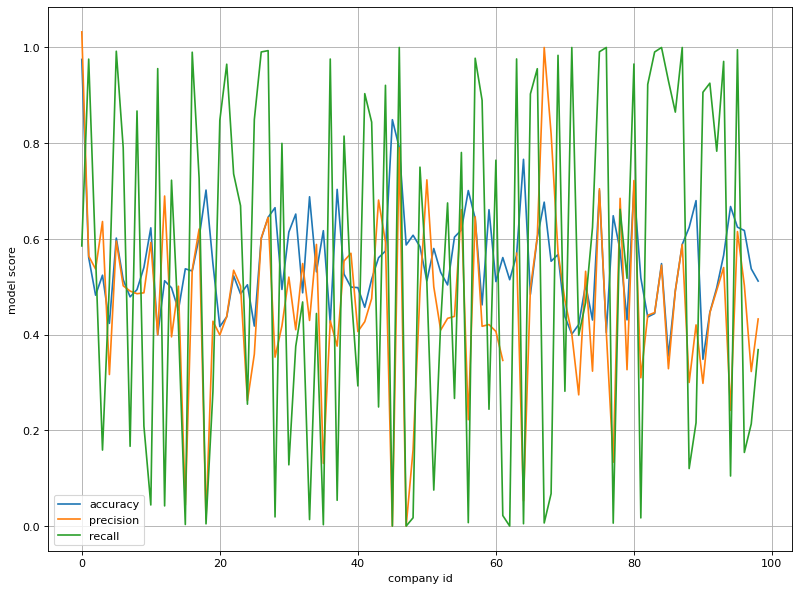

In [ ]:
figure(figsize=(12, 9), dpi=80)

plt.axes(xlabel='company id', ylabel='model score')
#plt.xticks(np.arange(len(comps)), comps, rotation='75')
#plt.yticks(np.arange(11)*0.1)

plt.grid()
for i in range(3):
    plt.plot(np.sum(scores_all, axis=2)[:,0,i]/3)
#plt.plot(np.sum(scores_true, axis=1)[:,0]/10)
plt.legend(['accuracy', 'precision', 'recall'])
print(np.sum(scores_all, axis=(0,2))[0]/3)
plt.show()
#logreg

[53.07578947 47.75417136 49.41325816]


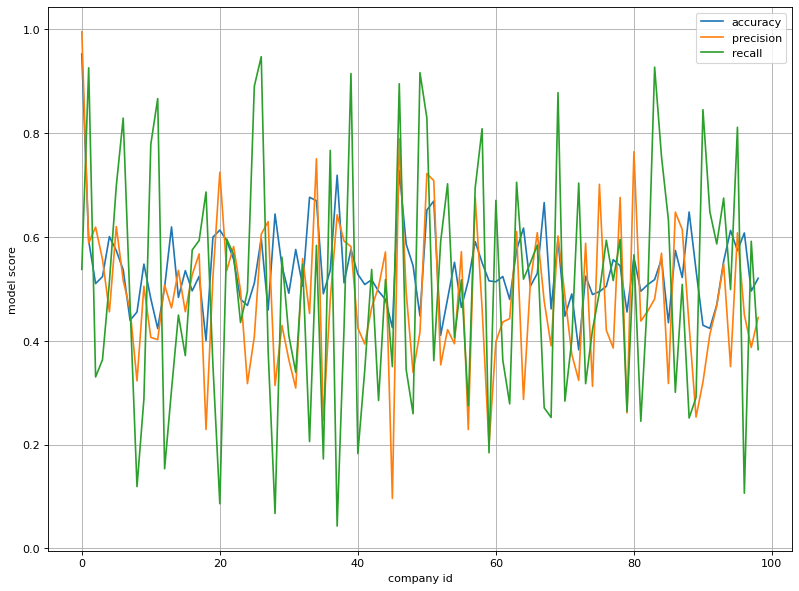

In [ ]:
figure(figsize=(12, 9), dpi=80)

plt.axes(xlabel='company id', ylabel='model score')
#plt.xticks(np.arange(len(comps)), comps, rotation='75')
#plt.yticks(np.arange(11)*0.1)

plt.grid()
for i in range(3):
    plt.plot(np.sum(scores_all, axis=2)[:,1,i]/3)
#plt.plot(np.sum(scores_true, axis=1)[:,0]/10)
plt.legend(['accuracy', 'precision', 'recall'])
print(np.sum(scores_all, axis=(0,2))[1]/3)
plt.show()
#dec tree

[53.31578947 48.26465036 48.54339215]


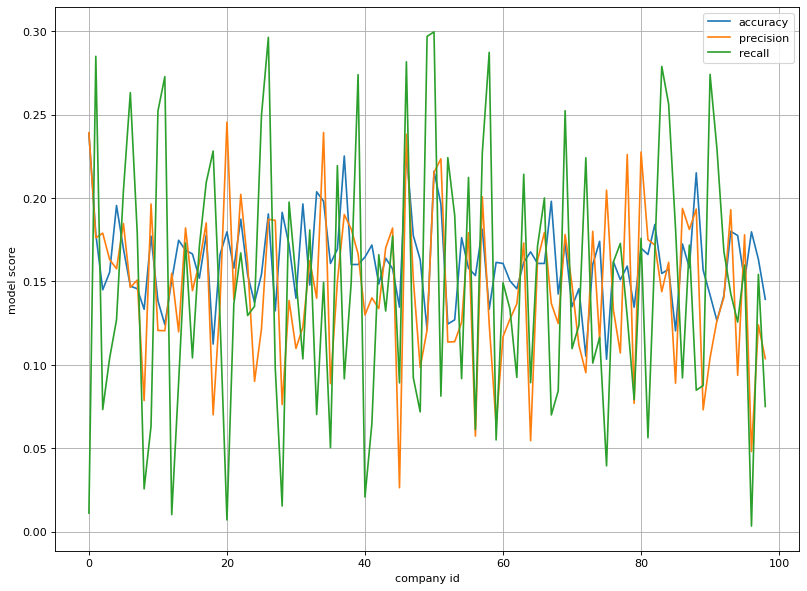

In [ ]:
figure(figsize=(12, 9), dpi=80)

plt.axes(xlabel='company id', ylabel='model score')
#plt.xticks(np.arange(len(comps)), comps, rotation='75')
#plt.yticks(np.arange(11)*0.1)

plt.grid()
for i in range(3):
    plt.plot(np.sum(scores_all, axis=2)[:,2,i]/10)
#plt.plot(np.sum(scores_true, axis=1)[:,0]/10)
plt.legend(['accuracy', 'precision', 'recall'])
print(np.sum(scores_all, axis=(0,2))[2]/3)
plt.show()
#xgb

# Skipping parameters

## skipping calculations

In [ ]:

split_percent = 0.8

names_all=[         
    'true_price', 
    'order_inbalance', 
    'vwaps_buy', 
    'vwaps_sell', 
    's2f_impact_buy', 
    's2f_impact_sell', 
    'trading_volumes', 
    'vwaps_order_sizes_buy', 
    'vwaps_order_sizes_sell',
    's2f_order_sizes_buy', 
    's2f_order_sizes_sell',
    'next_trade_time',
    'next_trade_size',
    'next_trade_price',
      ]
comps=np.arange(99)
names_len=len(names_all)
names_dict={}
for name in names_all:
    names_dict[name]=[]
param_dict_logreg={}
for n in names_all:
    param_dict_logreg[n]=[]
scores_skipped=np.zeros(shape=(len(comps), len(names_all), 3, 5, 3)) # comp. name, model, 5 times for avg, acc/prec/rec
none_skipped=np.zeros(shape=(len(comps), 3, 5, 3))
models=[logistic_regr, decision_tree, XGB]

In [ ]:
skipped_params=[]

for n in range(0, names_len):
    name=names_all.pop(0)
    print('skipping ', name, '\n')
    for c in range(99):
        for m in range(len(models)):
            for avg in range(3):
                pom_acc, pom_prec, pom_rec=models[m](np.delete(X_all[c], n, axis=1), 
                                                       np.copy(y_all[c]),split_percent, 
                                                       comps[c], use_pipe=preprocessing.MaxAbsScaler(), check_up_down=False, local_names=names_all, 
                                                       track_params=False)
                scores_skipped[c,n,m,avg,0]=pom_acc
                scores_skipped[c,n,m,avg,1]=pom_prec
                scores_skipped[c,n,m,avg,2]=pom_rec

    names_all.append(name)
    skipped_params.append(name)
    print('skipped ', name, '\n')
clear_output()


Text(0.5, 1.0, 'accuracy')

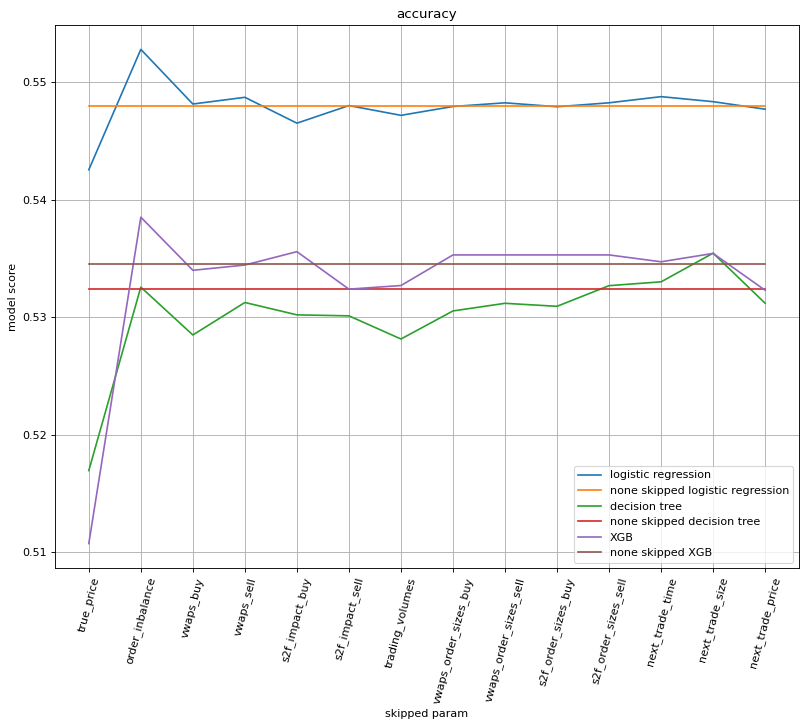

In [ ]:
figure(figsize=(12, 9), dpi=80)

plt.axes(xlabel='skipped param', ylabel='model score')
plt.xticks(np.arange(len(skipped_params)), skipped_params, rotation='75')
#plt.yticks(np.arange(11)*0.1)

plt.grid()
for i in range(3):
    plt.plot(np.nansum(scores_skipped, axis=(0,3))[:,i,0]/(99*3)) 
    plt.plot(np.repeat(np.nansum(none_skipped, axis=(0,2))[i,0]/(99*3), repeats=len(names_all), axis=0))
#plt.plot(np.sum(scores_true, axis=1)[:,0]/10)
plt.legend(['logistic regression', 'none skipped logistic regression', 
            'decision tree', 'none skipped decision tree', 
            'XGB', 'none skipped XGB'])
plt.title('accuracy')

Text(0.5, 1.0, 'accuracy')

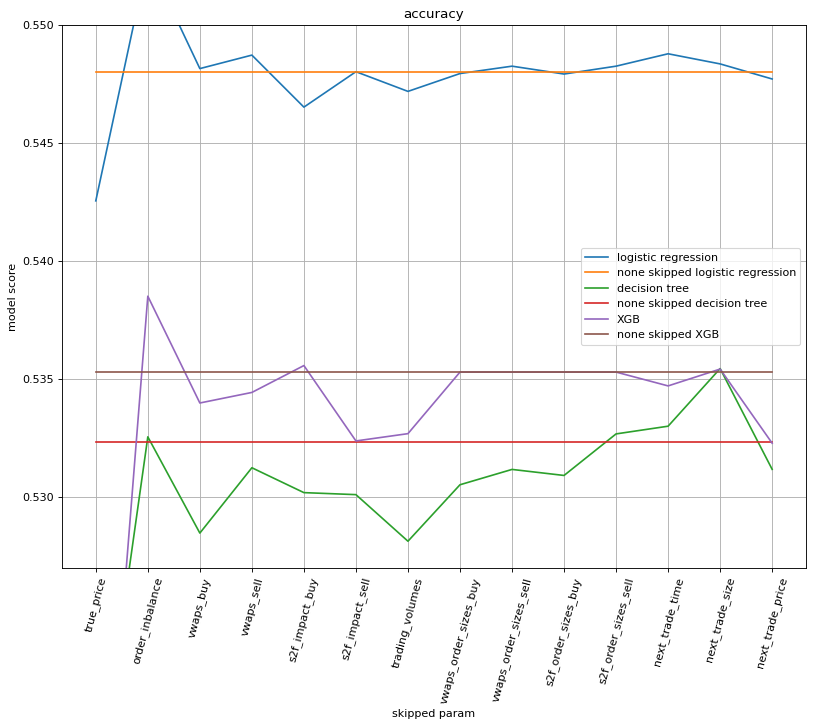

In [ ]:
figure(figsize=(12, 9), dpi=80)

plt.axes(xlabel='skipped param', ylabel='model score')
plt.xticks(np.arange(len(skipped_params)), skipped_params, rotation='75')
#plt.yticks(np.arange(11)*0.1)

plt.grid()
for i in range(3):
    plt.plot(np.nansum(scores_skipped, axis=(0,3))[:,i,0]/(99*3)) #stopped after 56th comp
    plt.plot(np.repeat(np.nansum(none_skipped, axis=(0,2))[i,0]/(99*3), repeats=len(names_all), axis=0))
#plt.plot(np.sum(scores_true, axis=1)[:,0]/10)
plt.legend(['logistic regression', 'none skipped logistic regression', 
            'decision tree', 'none skipped decision tree', 
            'XGB', 'none skipped XGB'])
plt.ylim(0.527, 0.55)
plt.title('accuracy')

Text(0.5, 1.0, 'precision')

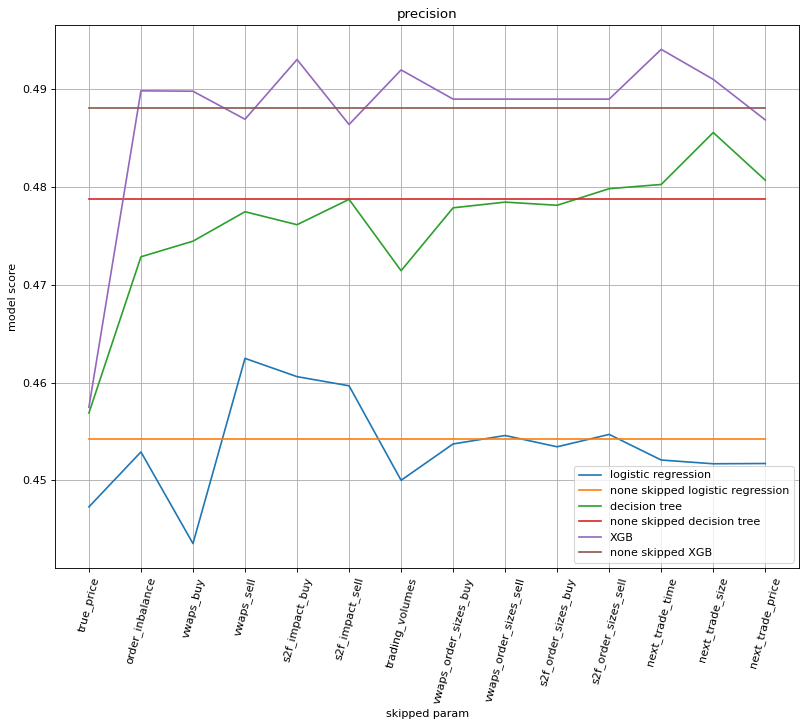

In [ ]:
figure(figsize=(12, 9), dpi=80)

plt.axes(xlabel='skipped param', ylabel='model score')
plt.xticks(np.arange(len(skipped_params)), skipped_params, rotation='75')
#plt.yticks(np.arange(11)*0.1)

plt.grid()
for i in range(3):
    plt.plot(np.nansum(scores_skipped, axis=(0,3))[:,i,1]/(99*3)) #stopped after 56th comp
    plt.plot(np.repeat(np.nansum(none_skipped, axis=(0,2))[i,1]/(99*3), repeats=len(names_all), axis=0))
#plt.plot(np.sum(scores_true, axis=1)[:,0]/10)
plt.legend(['logistic regression', 'none skipped logistic regression', 
            'decision tree', 'none skipped decision tree', 
            'XGB', 'none skipped XGB'])
plt.title('precision')

Text(0.5, 1.0, 'recall')

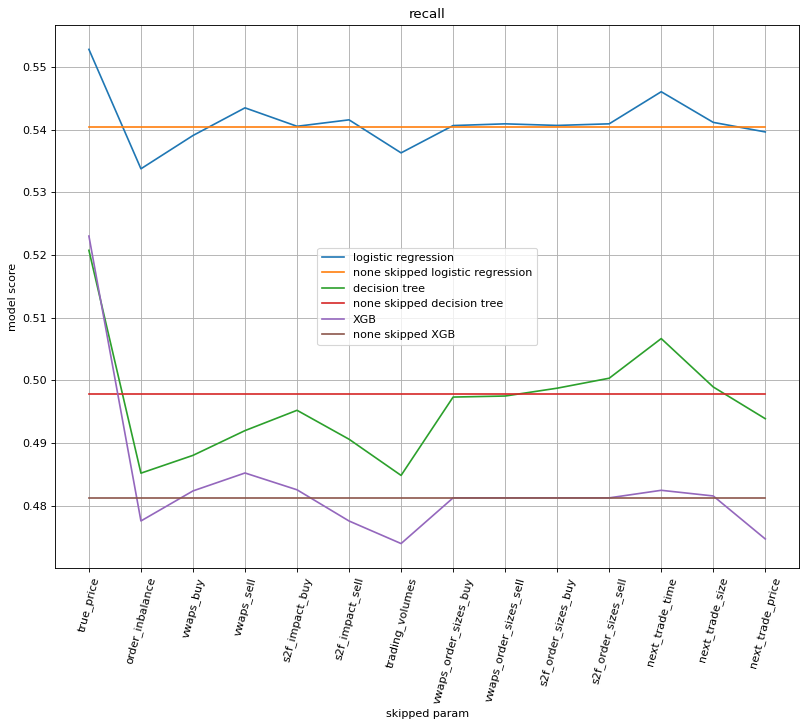

In [ ]:
figure(figsize=(12, 9), dpi=80)

plt.axes(xlabel='skipped param', ylabel='model score')
plt.xticks(np.arange(len(skipped_params)), skipped_params, rotation='75')
#plt.yticks(np.arange(11)*0.1)

plt.grid()
for i in range(3):
    plt.plot(np.nansum(scores_skipped, axis=(0,3))[:,i,2]/(99*3)) #stopped after 56th comp
    plt.plot(np.repeat(np.nansum(none_skipped, axis=(0,2))[i,2]/(99*3), repeats=len(names_all), axis=0))
#plt.plot(np.sum(scores_true, axis=1)[:,0]/10)
plt.legend(['logistic regression', 'none skipped logistic regression', 
            'decision tree', 'none skipped decision tree', 
            'XGB', 'none skipped XGB'])
plt.title('recall')

## skip subset of features, plot performance


In [ ]:
interval=1
time_back=5
time_to_skip=30
split_percent = 0.8
threshold = 0.00167
names_all=[         
    'true_price', 
    'order_inbalance', 
    'vwaps_buy', 
    'vwaps_sell', 
    's2f_impact_buy', 
    's2f_impact_sell', 
    'trading_volumes', 
    'vwaps_order_sizes_buy', 
    'vwaps_order_sizes_sell',
    's2f_order_sizes_buy', 
    's2f_order_sizes_sell',
    'next_trade_time',
    'next_trade_size',
    'next_trade_price',
      ]
names_part=[         
    #'true_price', 
    'order_inbalance', 
    'vwaps_buy', 
    'vwaps_sell', 
    's2f_impact_buy', 
    's2f_impact_sell', 
    'trading_volumes', 
    'vwaps_order_sizes_buy', 
    'vwaps_order_sizes_sell',
    's2f_order_sizes_buy', 
    's2f_order_sizes_sell',
    'next_trade_time',
    'next_trade_size',
    'next_trade_price',
      ]

to_delete=[]
for n in names_all:
    if n not in names_part:
        to_delete.append(names_all.index(n))

        
comps=np.arange(99)
scores_no_sizes=np.zeros(shape=(len(comps), 3, 5, 4))
models=[logistic_regr, decision_tree, XGB]

In [ ]:
## no true price test
for c in range(len(comps)):
    print(c)
#    X=get_X(comps[c], interval, time_to_skip, time_back, names_all)
 #   y=get_y(comps[c], interval, time_to_skip, time_back, y_name='true_price', check='swing_max', threshold=threshold)
    X=X_all[c]
    y=y_all[c]
    for i in range(3):
        for m in range(len(models)):
            start_time=time.time()
            scores_no_sizes[c,m,i,0], scores_no_sizes[c,m,i,1],scores_no_sizes[c,m,i,2]=(models[m](np.delete(X, to_delete, axis=1), np.copy(y),split_percent, c, 
                                                                                       use_pipe=preprocessing.MaxAbsScaler(), check_up_down=False, local_names=names_part))
            scores_no_sizes[c,m,i,3]=time.time()-start_time
clear_output()

In [ ]:
print("rows->logreg,dectree,xgb")


for row in np.round(np.nansum(scores_no_sizes, axis=(0,2))/(3*99), decimals=4):
    out=''
    for col in row:
        out+=' & '+str(col*100)
    print(out)

rows->logreg,dectree,xgb
 & 54.25 & 44.71 & 55.28999999999999 & 3.75
 & 51.88 & 45.89 & 51.970000000000006 & 10.32
 & 51.07000000000001 & 45.739999999999995 & 52.32 & 65.64


Text(0.5, 1.0, 'Logistic regression')

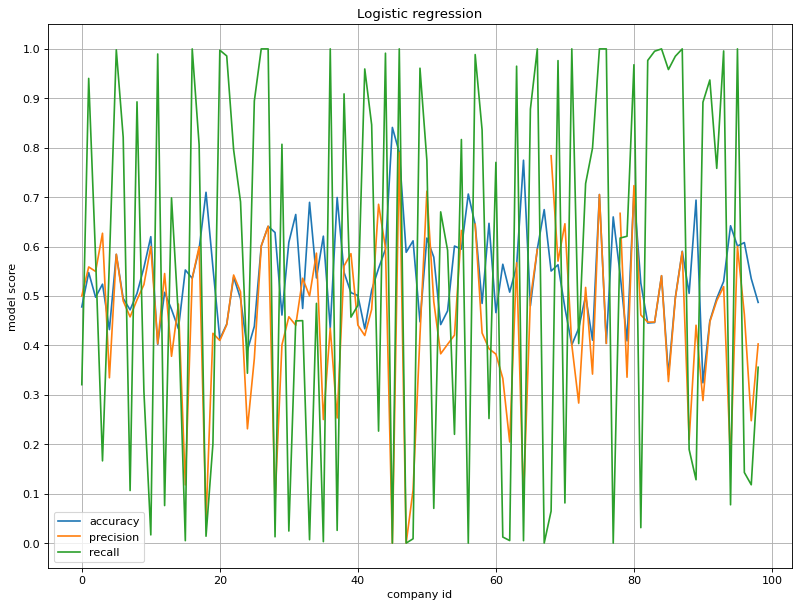

In [ ]:
figure(figsize=(12, 9), dpi=80)

plt.axes(xlabel='company id', ylabel='model score')
#plt.xticks(np.arange(len(comps)), comps, rotation='75')
plt.yticks(np.arange(11)*0.1)

plt.grid()
for i in range(3):
    plt.plot(np.sum(scores_no_sizes, axis=2)[:,0,i]/3)
#plt.plot(np.sum(scores_true, axis=1)[:,0]/10)
plt.legend(['accuracy', 'precision', 'recall'])
plt.title('Logistic regression')
#logreg

Text(0.5, 1.0, 'Decission tree')

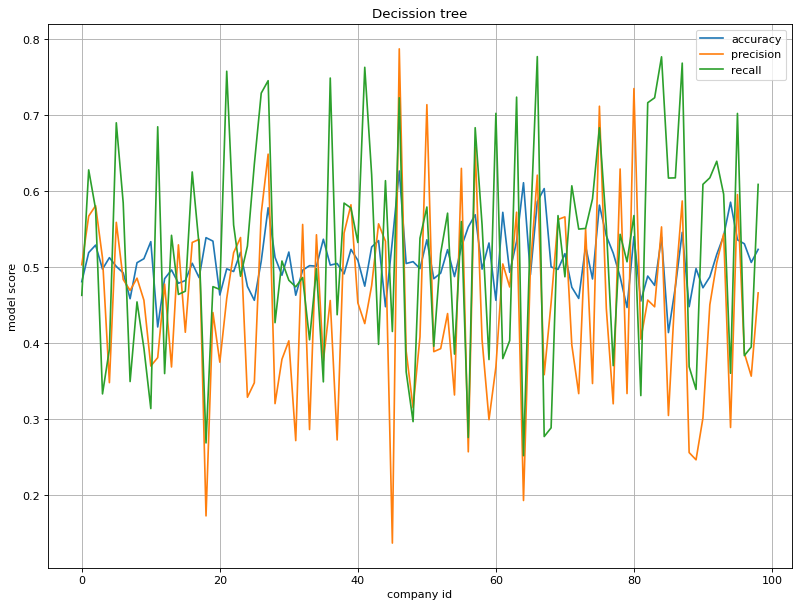

In [ ]:
figure(figsize=(12, 9), dpi=80)

plt.axes(xlabel='company id', ylabel='model score')
#plt.xticks(np.arange(len(comps)), comps, rotation='75')
plt.yticks(np.arange(11)*0.1)

plt.grid()
for i in range(3):
    plt.plot(np.sum(scores_no_sizes, axis=2)[:,1,i]/3)
#plt.plot(np.sum(scores_true, axis=1)[:,0]/10)
plt.legend(['accuracy', 'precision', 'recall'])
plt.title('Decission tree')


Text(0.5, 1.0, 'XGBoost')

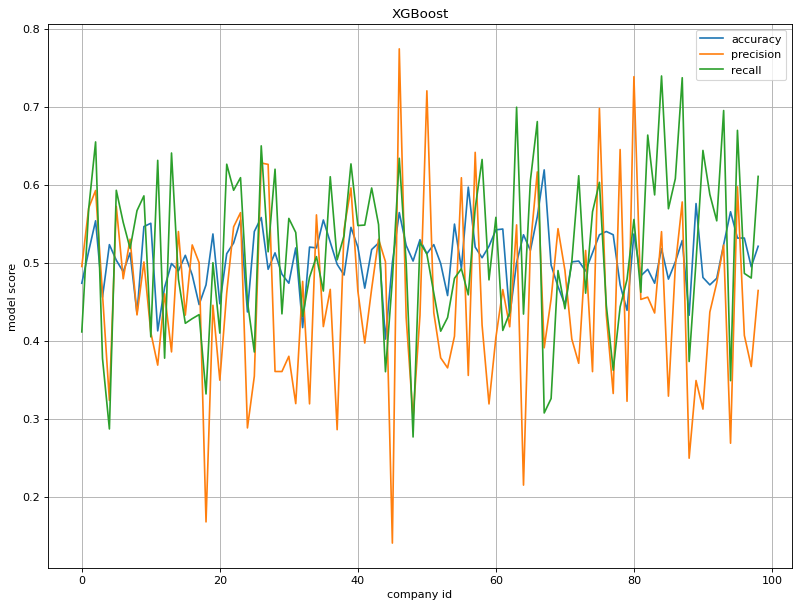

In [ ]:
figure(figsize=(12, 9), dpi=80)

plt.axes(xlabel='company id', ylabel='model score')
#plt.xticks(np.arange(len(comps)), comps, rotation='75')
plt.yticks(np.arange(11)*0.1)

plt.grid()
for i in range(3):
    plt.plot(np.sum(scores_no_sizes, axis=2)[:,2,i]/3)
#plt.plot(np.sum(scores_true, axis=1)[:,0]/10)
plt.legend(['accuracy', 'precision', 'recall'])
plt.title('XGBoost')

# MLP

## MLP performance testing

### all params

In [ ]:

names_all=[         
   # 'mid_price',
    'true_price', 
    'order_inbalance', 
    'vwaps_buy', 
    'vwaps_sell', 
    's2f_impact_buy', 
    's2f_impact_sell', 
    'trading_volumes', 
  #  'price_volatilities', #bug in computation
    'vwaps_order_sizes_buy', 
    'vwaps_order_sizes_sell',
    's2f_order_sizes_buy', 
    's2f_order_sizes_sell',
    'next_trade_time',
    'next_trade_size',
    'next_trade_price',
    #'price change'
      ]
comps=np.arange(99)
scores_all=np.zeros(shape=(len(comps), 3, 4))

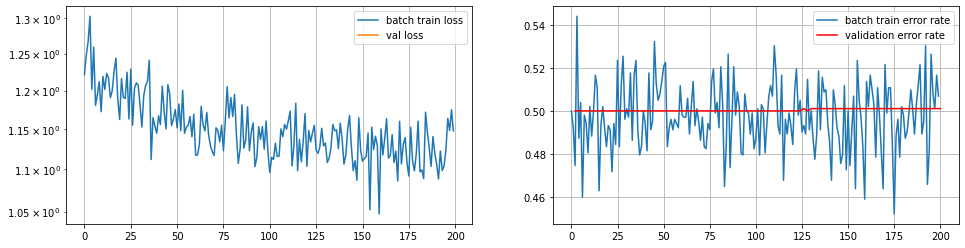

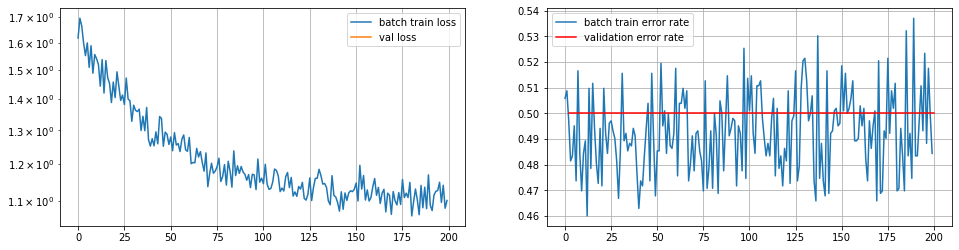

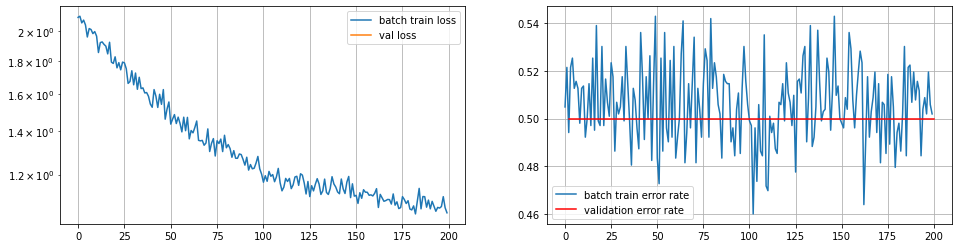

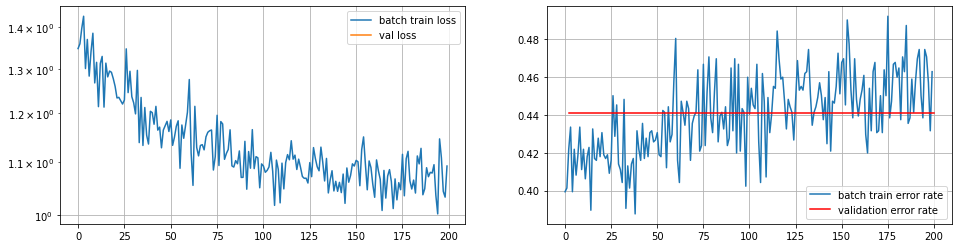

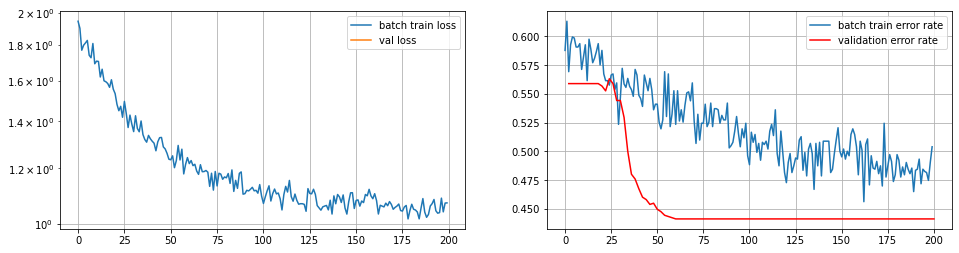

...

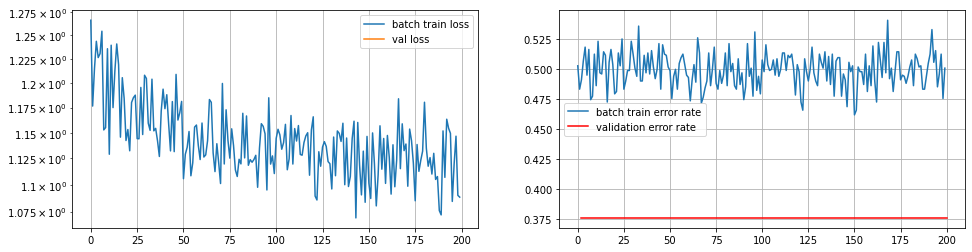

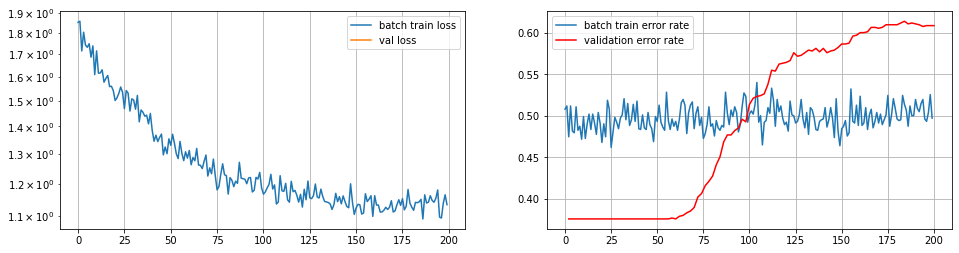

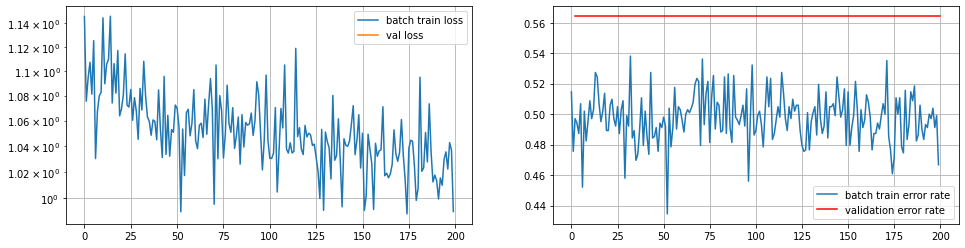

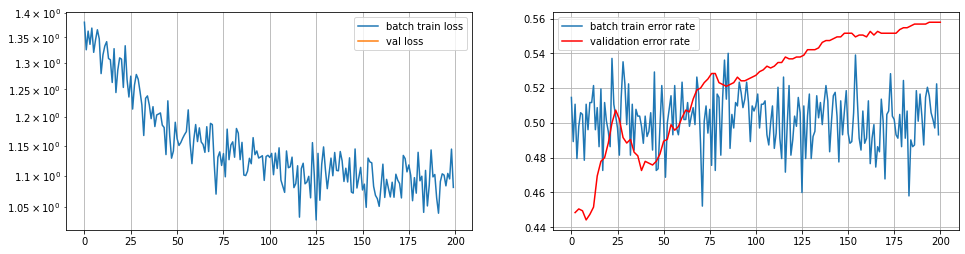

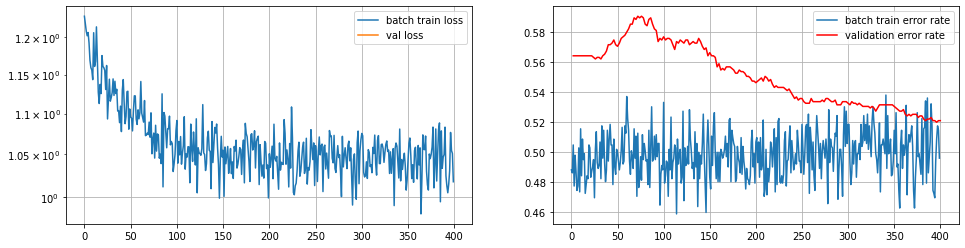

In [ ]:

for c in range(len(comps)):
    print(c)
#    X=get_X(comps[c], interval, time_to_skip, time_back, names_all)
 #   y=get_y(comps[c], interval, time_to_skip, time_back, y_name='true_price', check='swing_max', threshold=threshold)
    X=X_all[c]
    y=y_all[c]
    for i in range(3):
      start_time=time.time()
      scores_all[c,i,0], scores_all[c,i,1],scores_all[c,i,2]=MLP_wrapper(X, y, names=names_all)
      scores_all[c,i,3]=time.time()-start_time
clear_output()

In [ ]:
np.round(np.nansum(scores_all, axis=(0,1))/(3*99), decimals=4)
# accuracy, precision, recall and  train time

array([ 0.5291,  0.3729,  0.542 , 15.0037])

Text(0.5, 1.0, 'MLP')

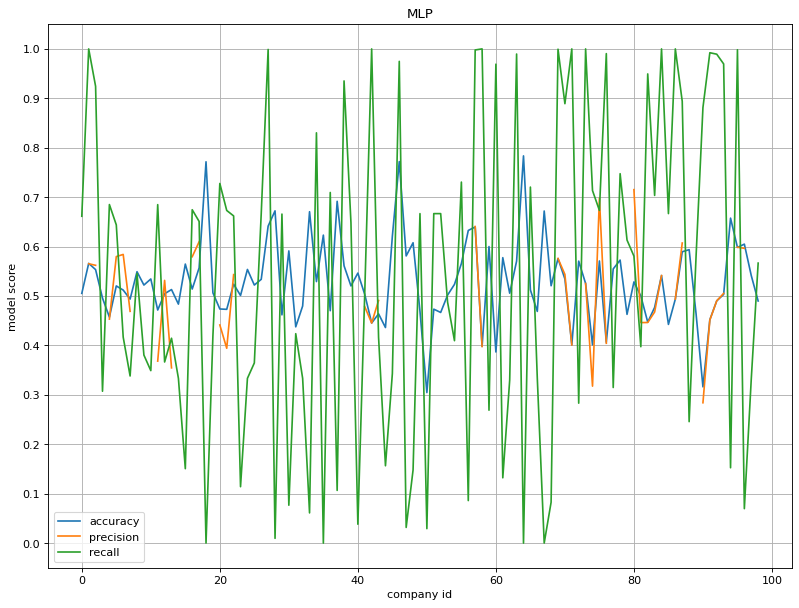

In [ ]:
figure(figsize=(12, 9), dpi=80)

plt.axes(xlabel='company id', ylabel='model score')
#plt.xticks(np.arange(len(comps)), comps, rotation='75')
plt.yticks(np.arange(11)*0.1)

plt.grid()
for i in range(3):
    plt.plot(np.sum(scores_all, axis=1)[:,i]/3)
#plt.plot(np.sum(scores_true, axis=1)[:,0]/10)
plt.legend(['accuracy', 'precision', 'recall'])
plt.title('MLP')

### price only

In [ ]:
comps=np.arange(99)
scores_price=np.zeros(shape=(len(comps), 3, 4))

In [ ]:

for comp_id in range(len(comps)-64):
    c=comp_id+64
    print(c)
#    X=get_X(comps[c], interval, time_to_skip, time_back, names_all)
 #   y=get_y(comps[c], interval, time_to_skip, time_back, y_name='true_price', check='swing_max', threshold=threshold)
    X=X_all[c, :, 0]
    y=y_all[c]
    for i in range(3):
      start_time=time.time()
      scores_price[c,i,0], scores_price[c,i,1],scores_price[c,i,2]=MLP_wrapper(X, y, names=['true_price'])
      scores_price[c,i,3]=time.time()-start_time
clear_output()

In [ ]:
np.round(np.nansum(scores_price, axis=(0,1))/(3*99), decimals=4)


array([ 0.5246,  0.2705,  0.4773, 12.8874])

Text(0.5, 1.0, 'MLP')

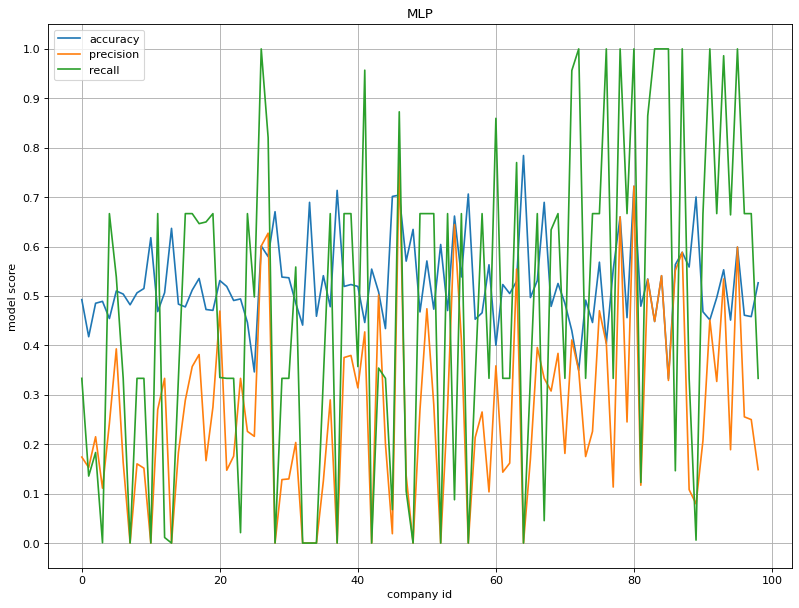

In [ ]:
figure(figsize=(12, 9), dpi=80)

plt.axes(xlabel='company id', ylabel='model score')
#plt.xticks(np.arange(len(comps)), comps, rotation='75')
plt.yticks(np.arange(11)*0.1)

plt.grid()
for i in range(3):
    plt.plot(np.nansum(scores_price, axis=1)[:,i]/3)
#plt.plot(np.sum(scores_true, axis=1)[:,0]/10)
plt.legend(['accuracy', 'precision', 'recall'])
plt.title('MLP')

### discard subset of features, plot performance per comp

In [ ]:
split_percent = 0.8

names_all=[         
   # 'mid_price',
    'true_price', 
    'order_inbalance', 
    'vwaps_buy', 
    'vwaps_sell', 
    's2f_impact_buy', 
    's2f_impact_sell', 
    'trading_volumes', 
  #  'price_volatilities', #bug in computation
    'vwaps_order_sizes_buy', 
    'vwaps_order_sizes_sell',
    's2f_order_sizes_buy', 
    's2f_order_sizes_sell',
    'next_trade_time',
    'next_trade_size',
    'next_trade_price',
    #'price change'
      ]
names_part=[         
   # 'mid_price',
    'true_price', 
    'order_inbalance', 
    'vwaps_buy', 
    'vwaps_sell', 
    's2f_impact_buy', 
    's2f_impact_sell', 
    'trading_volumes', 
  #  'price_volatilities', #bug in computation
    'next_trade_time',
    'next_trade_size',
    'next_trade_price',
    #'price change'
      ]

to_delete=[]
for n in names_all:
    if n not in names_part:
        to_delete.append(names_all.index(n))

        
comps=np.arange(99)
scores_no_sizes=np.zeros(shape=(len(comps), 3, 4))


In [ ]:

for c in range(len(comps)):
    print(c)
#    X=get_X(comps[c], interval, time_to_skip, time_back, names_all)
 #   y=get_y(comps[c], interval, time_to_skip, time_back, y_name='true_price', check='swing_max', threshold=threshold)
    X=X_all[c]
    y=y_all[c]
    for i in range(3):
      start_time=time.time()
      scores_no_sizes[c,i,0], scores_no_sizes[c,i,1],scores_no_sizes[c,i,2]=MLP_wrapper(np.delete(X, to_delete, axis=1), y, names=names_part)
      scores_no_sizes[c,i,3]=time.time()-start_time
clear_output()

----------------------------------------------------------
After epoch 30 | valid err rate: 62.42% | doing 100 epochs
----------------------------------------------------------


In [ ]:
np.round(np.nansum(scores_no_sizes, axis=(0,1))/(3*99), decimals=4)


array([ 0.5323,  0.3982,  0.4984, 16.1342])

Text(0.5, 1.0, 'MLP')

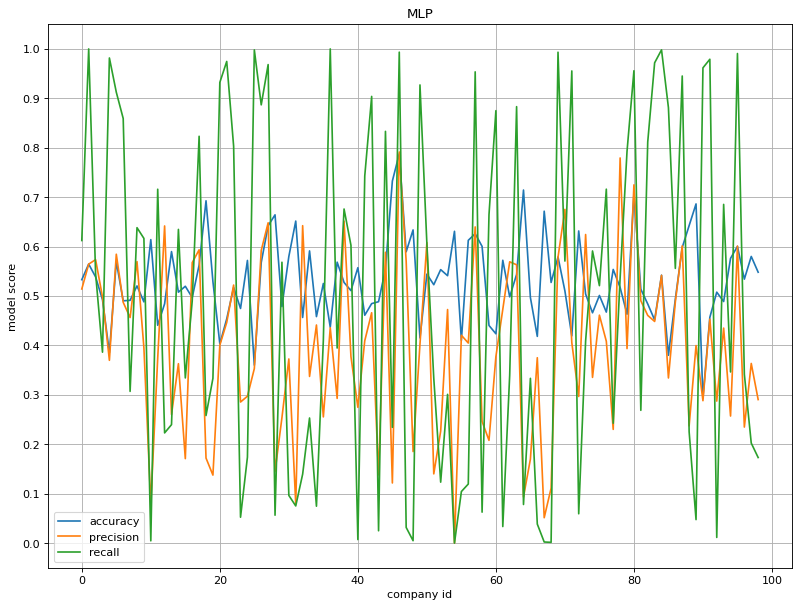

In [ ]:
figure(figsize=(12, 9), dpi=80)

plt.axes(xlabel='company id', ylabel='model score')
#plt.xticks(np.arange(len(comps)), comps, rotation='75')
plt.yticks(np.arange(11)*0.1)

plt.grid()
for i in range(3):
    plt.plot(np.nansum(scores_no_sizes, axis=1)[:,i]/3)
#plt.plot(np.sum(scores_true, axis=1)[:,0]/10)
plt.legend(['accuracy', 'precision', 'recall'])
plt.title('MLP')

## model trained on ALL companies

In [ ]:

split_percent = 0.6
valid_percent=split_percent+0.2
names=[         
   # 'mid_price',
    'true_price', 
    'order_inbalance', 
    'vwaps_buy', 
    'vwaps_sell', 
    's2f_impact_buy', 
    's2f_impact_sell', 
    'trading_volumes', 
    'vwaps_order_sizes_buy', 
    'vwaps_order_sizes_sell',
    's2f_order_sizes_buy', 
    's2f_order_sizes_sell',
    'next_trade_time',
    'next_trade_size',
    'next_trade_price',
    #'price change'
      ]
no_comps=99#len(list_of_companies_number)
split=int(X_all.shape[1]*split_percent)
valid=int(X_all.shape[1]*valid_percent)

In [ ]:
X_all=torch.tensor(X_all, dtype=torch.float32)
y_all=torch.tensor(y_all, dtype=torch.long)

In [ ]:

### Randomly permute racords of all companies in the training set
X_train=X_all[:,:split]
w=X_train.shape[0]
h=X_train.shape[1]
X_train=X_train.reshape(w*h, X_train.shape[2])
y_train=y_all[:,:split].flatten()

Xy_train=np.empty(shape=(X_train.shape[0], X_train.shape[1]+1))
Xy_train[:,:14]=X_train
Xy_train[:,14]=y_train
Xy_train=np.random.permutation(Xy_train)
X_train=Xy_train[:,:14]

X_train=torch.tensor(X_train, dtype=torch.float32)
y_train=prep_y_MLP(Xy_train[:,14])


print(y_train.shape, X_train.shape)


X_valid=X_all[:,split:valid]
w=X_valid.shape[0]
h=X_valid.shape[1]
X_valid=X_valid.reshape(w*h, X_valid.shape[2])
y_valid=prep_y_MLP(y_all[:,split:valid].flatten())

X_test=X_all[:,valid:]
w=X_test.shape[0]
h=X_test.shape[1]
X_test=X_test.reshape(w*h, X_test.shape[2])
y_test=prep_y_MLP(y_all[:,valid:].flatten())





torch.Size([284526, 2]) torch.Size([284526, 14])


In [ ]:
torch.cuda.is_available()

True

-----------------------------------------------------------
After epoch 100 | valid err rate: 52.65% | doing 100 epochs
-----------------------------------------------------------

Loading best params on validation set (epoch 1)

[[39258 46474]
 [ 3916  5194]]
precision: 0.457915364158074, recall: 0.9092972622411637
---------------------------------------------
Test error rate: 53.130%, training took 182s.
---------------------------------------------


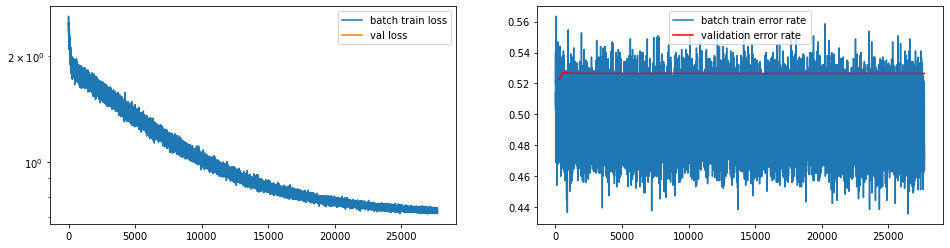

In [ ]:
 MLP=Model(nn.Linear(len(names), 128), nn.Sigmoid(), nn.Dropout(p=0.2), 
          nn.Linear(128, 512), nn.Sigmoid(),        nn.Dropout(p=0.5),
          nn.Linear(512, 1024), nn.Sigmoid(),       nn.Dropout(p=0.5),
          nn.Linear(1024, 4096), nn.Sigmoid(),      nn.Dropout(p=0.5),
          nn.Linear(4096, 4096), nn.Sigmoid(),      nn.Dropout(p=0.5),
       #   nn.Linear(4096, 4096), nn.Sigmoid(),      #nn.Dropout(p=0.5),
          nn.Linear(4096,1024), nn.Sigmoid(),       nn.Dropout(p=0.5),
          nn.Linear(1024,64), nn.Sigmoid(),         nn.Dropout(p=0.2),
          nn.Linear(64,2),# nn.ReLU(),
          #nn.Linear(8,2)
         )
with torch.no_grad():
    # Initialize parameters
    for name, p in MLP.named_parameters():
        if "weight" in name:
            p.normal_(1e-8, 1)
        elif "bias" in name:
          #  p.zero_()
            p.normal_(1e-8, 0.1)
        else:
            raise ValueError('Unknown parameter name "%s"' % name)
t_start = time.time()

hist=SGD(MLP, X_train, y_train,# X_test, y_test,
    X_valid, y_valid,
    alpha=5e-3, momentum=0.0001, decay=1e-4,beta=0.99,batch_size=1024, num_epochs=100, max_num_epochs=300, device='cuda')#, polyak=True)


test_err_rate = compute_error_rate(MLP, 
                                    X_test, y_test,
                                   )
get_model_precision_recall(MLP, 
                                   X_test, y_test,
                                   )
m = (
    f"Test error rate: {test_err_rate * 100.0:.3f}%, "
    f"training took {time.time() - t_start:.0f}s."
)
print("{0}\n{1}\n{0}".format("-" * len(m), m))

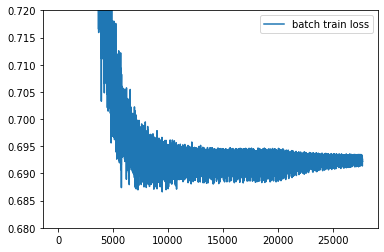

In [ ]:
train_errs = np.array(hist["train_losses"])
plt.plot(np.arange(train_errs.shape[0]), train_errs, label="batch train loss")

plt.ylim(0.68, 0.72)
plt.legend()